# In this notebook we will try to refine the initial performance of our network by doing data augmentation



## Setup environment for google colab & Download data


In [ ]:
%tensorflow_version 2.x
!python colab_setup.py
import os
os.environ['PYTHONPATH'] += ':/content/models/research/:/content/models/research/slim/'
os.environ['PYTHONPATH'] += ":/content/models"
!python3 -c 'import tensorflow as tf; print(tf.__version__)'
%cd Object_detection_in_urban_environments/

Requirement already up-to-date: pip==20.2.2 in /usr/local/lib/python3.6/dist-packages (20.2.2)
Archive:  Object_detection_in_urban_environments.zip
  inflating: Object_detection_in_urban_environments/.DS_Store  
   creating: Object_detection_in_urban_environments/.git/
 extracting: Object_detection_in_urban_environments/.git/COMMIT_EDITMSG  
  inflating: Object_detection_in_urban_environments/.git/config  
  inflating: Object_detection_in_urban_environments/.git/description  
 extracting: Object_detection_in_urban_environments/.git/HEAD  
   creating: Object_detection_in_urban_environments/.git/hooks/
  inflating: Object_detection_in_urban_environments/.git/hooks/applypatch-msg.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/commit-msg.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/post-update.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/pre-applypatch.sample  
  inflating: Object_detection_in_urban_environment

In [ ]:
## Download data script from waymo
!python download_process.py --data_dir ../data/ --temp_dir .

Streaming output truncated to the last 5000 lines.
(pid=2871) 2020-11-30 23:11:37,935 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=2871) 2020-11-30 23:11:37,935 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=2871) 2020-11-30 23:11:37,935 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=2871) 2020-11-30 23:11:37,935 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=2871) 2020-11-30 23:11:37,935 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid

In [ ]:
## Import libraries
import os
from utils import get_dataset
import tensorflow.compat.v1 as tf
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle
%matplotlib inline

In [ ]:
#get_dataset("../data/processed/*.tfrecord")

In [ ]:
## Create splits
!python create_splits.py --data_dir ../data/processed/

2020-11-30 23:39:04.434191: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-11-30 23:39:07,209 INFO     Creating splits...
2020-11-30 23:39:07.212656: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-11-30 23:39:07.217647: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-11-30 23:39:07.218280: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-11-30 23:39:07.218315: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-11-30 23:39:07.2

## Initial performance without data augmentation

In [ ]:
## Download SSD resnet50 network for training
!wget download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz 
!mkdir -p training/pretrained-models
!mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz ./training/pretrained-models/
!tar -xvzf ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz -C ./training/pretrained-models/
!rm -rf ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz


--2020-11-30 23:51:19--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.7.176, 2607:f8b0:4004:800::2010
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.7.176|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M  84.4MB/s    in 2.8s    

2020-11-30 23:51:22 (84.4 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]

ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/checkpoint
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_resnet

In [ ]:
## Create new configuration
!python edit_config.py --train_dir \
../data/processed/train/ \
--eval_dir ../data/processed/val/ \
--batch_size 3 \
--checkpoint ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0 \
--label_map label_map.pbtxt
## Move configuration to new folder
!mkdir ./training/reference
!mv pipeline_new.config ./training/reference/

2020-11-30 05:21:13.257599: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1


In [ ]:
## Training network
!python /content/models/research/object_detection/model_main_tf2.py \
--model_dir=training/reference/ \
--pipeline_config_path=training/reference/pipeline_new.config

2020-11-30 05:21:24.702859: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-11-30 05:21:28.228459: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-11-30 05:21:28.266946: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-11-30 05:21:28.267581: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-11-30 05:21:28.267622: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-11-30 05:21:28.523068: I tensorflow/stream_executor/platform/default

In [ ]:
## Evaluate network on validation dataset
!python /content/models/research/object_detection/model_main_tf2.py \
--model_dir=training/reference/ \
--pipeline_config_path=training/reference/pipeline_new.config \
--checkpoint_dir=training/reference/ \
--eval_timeout=60

2020-11-30 06:25:34.460403: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
W1130 06:25:37.999682 140470961166208 model_lib_v2.py:1026] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1130 06:25:37.999907 140470961166208 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1130 06:25:38.000001 140470961166208 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1130 06:25:38.000147 140470961166208 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1130 06:25:38.000288 140470961166208 model_lib_v2.py:1041] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2020-11-30 06:25:38.036726: I tensorflow/stream_executor/

In [ ]:
## Run tensorboard to visualize performance
%load_ext tensorboard
%tensorboard --logdir=training

<IPython.core.display.Javascript object>

# Explore data augmentations

This notebook will be used to test different data augmentation strategies. In your config file, you can modify the augmentations by adding `data_augmentation_options`. For example, I would like to add a random RGB to gray transform with a probability of 0.2:
```
data_augmentation_options {
    random_rgb_to_gray {
    probability: 0.2
    }
```

A complete list of augmentation is provided the [`preprocessor.proto` file of the Tf Object Detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/protos/preprocessor.proto).

In [ ]:
## Create new configuration
!python edit_config.py --train_dir \
../data/processed/train/ \
--eval_dir ../data/processed/val/ \
--batch_size 1 \
--checkpoint ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0 \
--label_map label_map.pbtxt \
--config_file pipeline_augmentation
## Move configuration to new folder
#!mkdir ./training/reference
!mv pipeline_new.config ./training/reference/

2020-12-01 01:28:57.556350: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1


### Helper functions

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

In [ ]:
def recenter_image(image):
    # ssd preprocessing
    image += [123.68, 116.779, 103.939]
    return image

def display_instances(image, bboxes, classes):
    image = recenter_image(image)
    w, h, _ = image.shape
    # resize the bboxes
    bboxes[:, [0, 2]] *= w
    bboxes[:, [1, 3]] *= h
    
    f, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image.astype(np.uint8))
    for bb, cl in zip(bboxes, classes):
        y1, x1, y2, x2 = bb
        rec = Rectangle((x1, y1), x2-x1, y2-y1, facecolor='none', edgecolor='r', linewidth=2)
        ax.add_patch(rec)
    plt.show()

def display_batch(batch):
    # get images, bboxes and classes
    batched_images = batch[0]['image'].numpy()
    batched_bboxes = batch[1]['groundtruth_boxes'].numpy()
    batched_classes = batch[1]['groundtruth_classes'].numpy()
    num_bboxes = batch[1]['num_groundtruth_boxes'].numpy()
    batch_size = batched_images.shape[0]
    for idx in range(batch_size):
        display_instances(batched_images[idx, ...], 
                          batched_bboxes[idx, :num_bboxes[idx], :],
                          batched_classes[idx, ...])

### Display augmentations

In [ ]:
from utils import get_train_input

In [ ]:
train_dataset = get_train_input("./training/reference/pipeline_new.config")

INFO:tensorflow:Reading unweighted datasets: ['../data/processed/train/train-47.tfrecord', '../data/processed/train/train-34.tfrecord', '../data/processed/train/train-31.tfrecord', '../data/processed/train/train-10.tfrecord', '../data/processed/train/train-41.tfrecord', '../data/processed/train/train-16.tfrecord', '../data/processed/train/train-20.tfrecord', '../data/processed/train/train-26.tfrecord', '../data/processed/train/train-11.tfrecord', '../data/processed/train/train-64.tfrecord', '../data/processed/train/train-44.tfrecord', '../data/processed/train/train-8.tfrecord', '../data/processed/train/train-36.tfrecord', '../data/processed/train/train-5.tfrecord', '../data/processed/train/train-63.tfrecord', '../data/processed/train/train-45.tfrecord', '../data/processed/train/train-38.tfrecord', '../data/processed/train/train-53.tfrecord', '../data/processed/train/train-48.tfrecord', '../data/processed/train/train-30.tfrecord', '../data/processed/train/train-24.tfrecord', '../data/pr

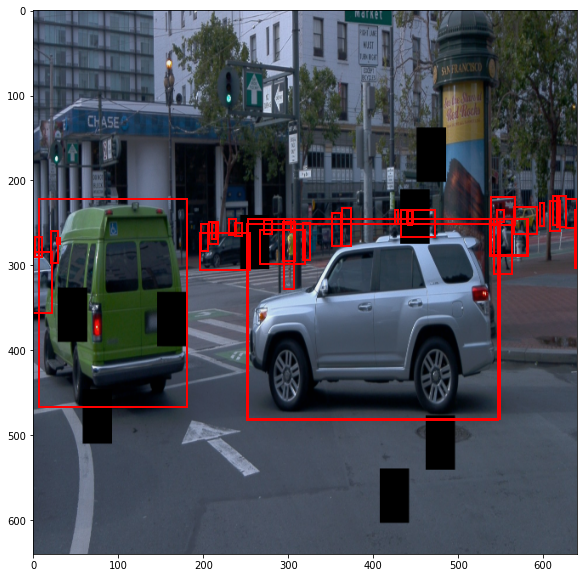

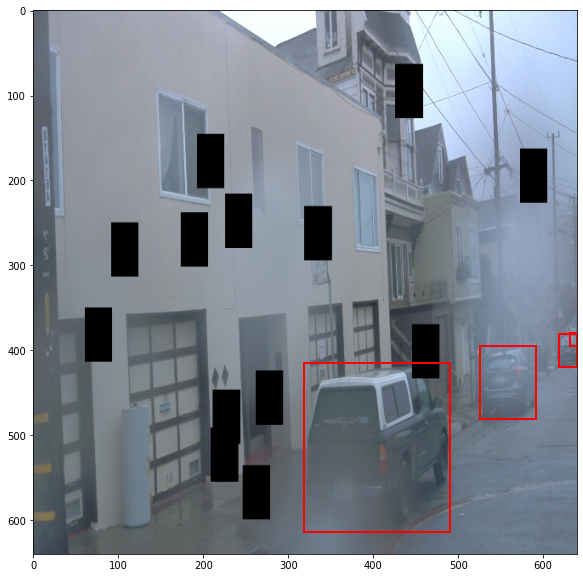

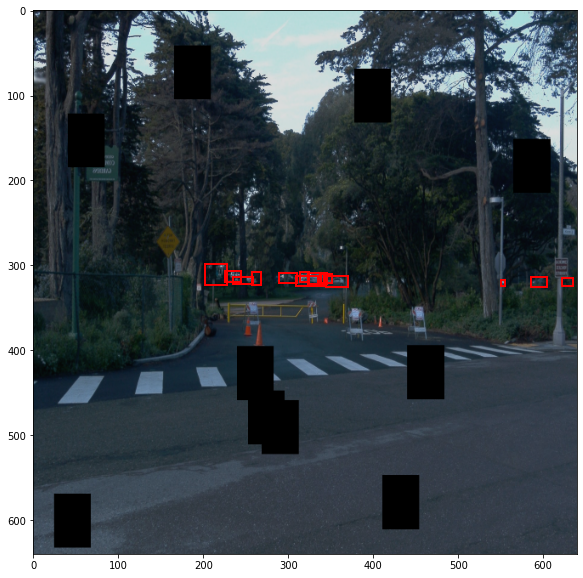

In [ ]:
%matplotlib inline

for batch in train_dataset.take(1):
    display_batch(batch)

## Let's train using this new augmented data

In [ ]:
## Training network
!python ./experiments/model_main_tf2.py \
--model_dir=training/reference/ \
--pipeline_config_path=training/reference/pipeline_new.config

2020-12-01 01:29:09.055284: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-12-01 01:29:12.666770: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-12-01 01:29:12.697146: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-12-01 01:29:12.697820: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-12-01 01:29:12.697858: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-12-01 01:29:12.929544: I tensorflow/stream_executor/platform/default

In [ ]:
## Evaluate network on validation dataset
!python ./experiments/model_main_tf2.py \
--model_dir=training/reference/ \
--pipeline_config_path=training/reference/pipeline_new.config \
--checkpoint_dir=training/reference/ \
--eval_timeout=60

In [ ]:
## Run tensorboard to visualize performance
%load_ext tensorboard
%tensorboard --logdir=training

## Export and Create a Video

In [78]:
!python ./experiments/exporter_main_v2.py \
--input_type image_tensor \
--pipeline_config_path ./training/reference/pipeline_new.config \
--trained_checkpoint_dir ./training/reference/ \
--output_directory training/experiment0/exported_model/

2020-12-01 05:59:19.884264: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-12-01 05:59:21.858985: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-12-01 05:59:21.863867: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-12-01 05:59:21.864547: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-12-01 05:59:21.864591: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-12-01 05:59:21.866361: I tensorflow/stream_executor/platform/default

In [88]:
!python ./inference_video.py \
--labelmap_path label_map.pbtxt \
--model_path training/experiment0/exported_model/saved_model \
--tf_record_path ../data/processed/inference_video/segment-10231929575853664160_1160_000_1180_000_with_camera_labels.tfrecord \
--config_path training/experiment0/exported_model/pipeline.config \
--output_path animation.mp4

2020-12-01 06:33:23.683726: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-12-01 06:33:25,432 INFO     Loading model from training/experiment0/exported_model/saved_model
2020-12-01 06:33:25.970959: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-12-01 06:33:25.975765: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-12-01 06:33:25.976373: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-12-01 06:33:25.976413: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic